In [1]:
import matplotlib.pyplot as plt
import cobra
from cobra.io import validate_sbml_model
import importlib
from xml.etree import ElementTree
import utils.Model_correction as mc
import sys
import utils.model_maj as mj
import utils.viz_utils as vu
#import cplex
import cbmpy
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from tqdm import tqdm
from itertools import cycle
import seaborn as sns

pyparsing import

INFO: No xlwt module available, Excel spreadsheet creation disabled
CBGLPK based on swiglpk: not all methods implimented yet! 5.0

*****
Using CPLEX
*****

doFBAMinSum not available with GLPK

INFO: No xlrd module available, Excel spreadsheet reading disabled


***********************************************************************
* Welcome to CBMPy (0.8.4) - PySCeS Constraint Based Modelling        *
*                http://cbmpy.sourceforge.net                         *
* Copyright(C) Brett G. Olivier 2014 - 2020                           *
* Systems Biology Lab, Vrije Universiteit Amsterdam                   *
* Amsterdam, The Netherlands                                          *
* CBMPy is developed as part of the BeBasic MetaToolKit Project       *
* Distributed under the GNU GPL v 3.0 licence, see                    *
* LICENCE (supplied with this release) for details                    *
***********************************************************************


In [50]:
importlib.reload(vu)
importlib.reload(mc)

<module 'utils.Model_correction' from '/home/jerem/Documents/master/RBA_cutsets/code/utils/Model_correction.py'>

### Models loading and bounds modification

In [2]:
HepG2_wmed, errors = validate_sbml_model("../models_storage/HepG2_medium.xml")
HepG2_wmed_original = HepG2_wmed.copy()

In [3]:
iHep, errors = validate_sbml_model("../models_storage/iHep_v3_genenames.xml")

In [4]:
HepG2_original, errors = validate_sbml_model("../models_storage/HepG2_v8.xml")

In [5]:
HepG2_original.reactions.EX_m01965x.bounds = (-1000.0,-1000.0) #Glucose exchange, set to the maximal input value observed with FVA
#iHep.reactions.EX_m01965x.bounds = (-1000.0, -1000.0)
iHep.reactions.HMR_4281.bounds = (0.0,0.0) # Blocking peroxysome fermentation in healthy model

HepG2_original.reactions.HMR_3883.bounds = (0.0,0.0) #Serine --> Pyruvate exchange
HepG2_original.reactions.EX_m02630x.bounds = (0.0,0.0) #O2 exchange
HepG2_original.reactions.EX_m02819x.bounds = (0.0,1000.0) #Pyruvate exchange
HepG2_original.reactions.EX_m01910x.bounds = (0.0,0.0) #Galactose exchange
HepG2_original.reactions.EX_m01743x.bounds = (0.0, 1000.0) #D-Ribulose exchange
HepG2_original.reactions.EX_m01962x.bounds = (0.0,1000.0) #glucosamine exchange
HepG2_original.reactions.HMR_4316.bounds = (-1000.0,1000.0) # Glucose --> D-Glucitol
HepG2_original.reactions.EX_m02896x.bounds = (0.0,1000.0) # Serine intake
HepG2_original.reactions.EX_m01682x.bounds = (-1000.0,0.0) # Glucitol secretion blocked. Kept the intake just in case.
HepG2_original.reactions.EX_m01840x.bounds = (-1000.0,0.0) #Fructose exchange
HepG2_original.reactions.HMR_4300.bounds = (494.6155049539209,494.6155049539209)
#HepG2.reactions.HMR_4281.bounds = (100.0,1000.0) #Fermentation perox.
#HepG2.reactions.HMR_4930.bounds = (-1000.0,1000.0) # Pyruvate transfer from cytoplasm to peroxysome
#HepG2.reactions.HMR_4281.bounds = (0.0,0.0) # Fermentation in peroxysome

In [16]:
HepG2_wmed.reactions.EX_m01965x.bounds = (-1000.0,-1000.0) #Glucose exchange, set to the maximal input value observed with FVA
#iHep.reactions.EX_m01965x.bounds = (-1000.0, -1000.0)
iHep.reactions.HMR_4281.bounds = (0.0,0.0) # Blocking peroxysome fermentation in healthy model

HepG2_wmed.reactions.HMR_3883.bounds = (0.0,0.0) #Serine --> Pyruvate exchange
HepG2_wmed.reactions.EX_m02630x.bounds = (-1000.0,1000.0) #O2 exchange
HepG2_wmed.reactions.EX_m02819x.bounds = (0.0,1000.0) #Pyruvate exchange
HepG2_wmed.reactions.EX_m01910x.bounds = (0.0,0.0) #Galactose exchange                                          #
HepG2_wmed.reactions.EX_m01743x.bounds = (0.0, 1000.0) #D-Ribulose exchange
HepG2_wmed.reactions.EX_m01962x.bounds = (0.0,1000.0) #glucosamine exchange
HepG2_wmed.reactions.HMR_4316.bounds = (-1000.0,1000.0) # Glucose --> D-Glucitol
HepG2_wmed.reactions.EX_m02896x.bounds = (-1000.0,1000.0) # Serine intake                                       #
HepG2_wmed.reactions.EX_m01682x.bounds = (0.0,0.0) # Glucitol secretion blocked. Kept the intake just in case.  #
HepG2_wmed.reactions.EX_m01840x.bounds = (0.0,0.0) #Fructose exchange                                           #
HepG2_wmed.reactions.HMR_4300.bounds = (494.6155049539209,494.6155049539209)
#HepG2.reactions.HMR_4281.bounds = (100.0,1000.0) #Fermentation perox.
#HepG2.reactions.HMR_4930.bounds = (-1000.0,1000.0) # Pyruvate transfer from cytoplasm to peroxysome
#HepG2.reactions.HMR_4281.bounds = (0.0,0.0) # Fermentation in peroxysome

### Optimisation

In [17]:
iHep.solver = "cplex"
iHep.objective = "biomass_components"
sol_iHep = iHep.optimize()
HepG2_wmed.solver = "cplex"
HepG2_wmed.objective = "biomass_components"
sol_G2 = HepG2_wmed.optimize()
HepG2_original.solver = "cplex"
HepG2_original.objective = "biomass_components"
sol_G2_original= HepG2_original.optimize()
HepG2_wmed_original.solver = "cplex"
HepG2_wmed_original.objective = "biomass_components"
sol_G2_med_original = HepG2_wmed_original.optimize()
print(f"iHep : {sol_iHep.objective_value}\tHepG2 : {sol_G2.objective_value}\tHepG2_original : {sol_G2_original.objective_value}\tHepG2_medium_original : {sol_G2_med_original.objective_value} ")

iHep : 164.15377751748838	HepG2 : 20.03322000452031	HepG2_original : 25.193875875297017	HepG2_medium_original : 22.356057805734764 


### Heatmap

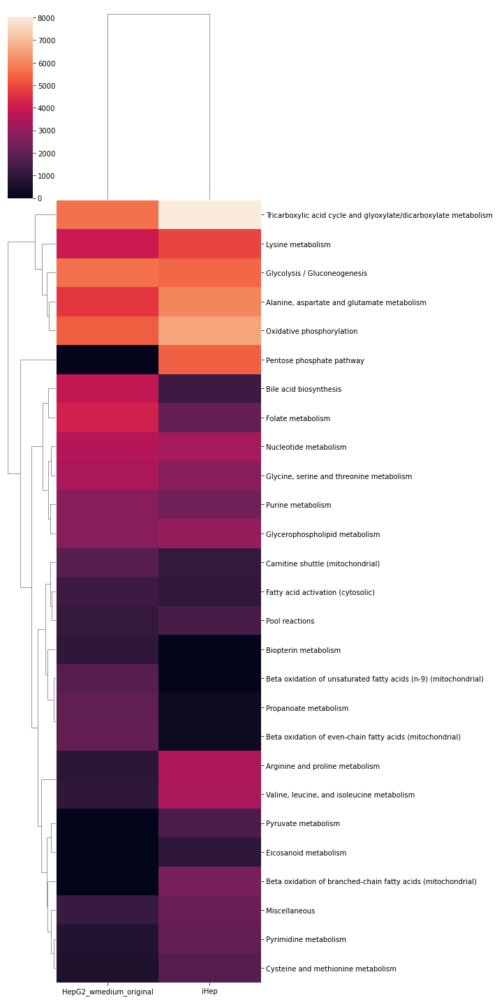

In [21]:
# df_Ci, df_Ri, df_Si, df_Mi, df_Pi, df_Xi, df_Li, df_Gi, df_Ni = vu.build_reaction_df(iHep)
# df_C, df_R, df_S, df_M, df_P, df_X, df_L, df_G, df_N = vu.build_reaction_df(HepG2)
subS_G2_med_mod = vu.get_subsystem_fluxes(vu.build_reaction_df(HepG2_wmed))
subS_iHep = vu.get_subsystem_fluxes(vu.build_reaction_df(iHep))
subS_G2_original = vu.get_subsystem_fluxes(vu.build_reaction_df(HepG2_original))
subS_G2_med_original = vu.get_subsystem_fluxes(vu.build_reaction_df(HepG2_wmed_original))
df_both = pd.concat([subS_G2_med_original, subS_iHep], axis = 1)
df_both.columns = ["HepG2_wmedium_original", "iHep"]
#df_both = df_both.loc[((df_both["iHep"]/df_both["HepG2"] >= 2.0) | (df_both["HepG2"]/df_both["iHep"] >= 2.0)) & ((df_both["HepG2"]>=1000.0) | (df_both["iHep"]>=1000.0))]  # --> Filtre relatif + absolu 
df_both = df_both.loc[(df_both["iHep"]>=1000.0) | (df_both["HepG2_wmedium_original"]>=1000.0)] # --> Filtre absolu
clustermap = sns.clustermap(df_both.fillna(0), figsize =(10,20))

Heatmap : Représentation sous forme d'une heatmap des flux de chaque sous-systèmes actif dans trois modèles de cellule du foie différentes :
* iHep : Modèle sain
* HepG2 : modèle cancéreux, aux réactions corrigées
* HepG2_copy : modèle cancéreux, aux réactions non corrigées.
 
On s'attend à observer une distribution des flux dirigée vers la production d'énergie, de nucléotides, d'acides aminés ou d'acides gras pour les modèles cancéreux.

La glycolyse est effectivement plus active dans le modèle HepG2 corrigé. \
On observe également une activité importante du métabolisme du folate dans le modèle HepG2 (métabolisme des nucléotides)\
Cependant, l'activité du métabolisme des pentoses phosphates reste bien trop faible, il en va de même pour le métabolisme du pyruvate.

---

#### Comparaison, par compartiment, des subsystems les plus actifs pour les deux modèles :
On s'attend à observer les différences suivantes dans le modèle cancéreux par rapport au modèle sain :
* activité accrue du métabolisme des nucléotides
* activité accrue de la voie des pentoses phosphates
* activité accrue de la glycolyse
* activité accrue de la voie de biosynthèse des hexosamines
* activité accrue de la lipogénèse


--> Résultats :
* Activité deux fois plus importante des réactions de glycolyse dans le cytoplasme du modèle cancéreux, par rapport au modèle sain.
* Activité bien plus importante de la voie des pentoses phosphates et du métabolisme des nucléotides dans le modèle sain.
* Activité 2x plus importante de l'activité du métabolisme de l'acide folique dans le cytoplasme du modèle cancéreux.
* Aucune différence significative repérée pour la lipogénèse ou la biosynthèse des hexosamines

Comparaison des flux attribués à chaque groupe de réactions entre le modèle sain et le modèle cancéreux

In [74]:
r = HepG2.reactions.HMR_0162
r.subsystem

'Carnitine shuttle (mitochondrial)'

### Barplots comparaison par groupe des flux associés à chaque gène

In [54]:
subS_dict_1 = vu.build_reaction_df(HepG2_wmed, by_compartment=False)
#subS_dict_merged = vu.merge_dict_keys(subS_dict, "glycolysis / gluconeogenesis", "pyruvate metabolism")

In [58]:
len(subS_dict_1["pyruvate metabolism"]["flux"])

27

In [59]:
len(subS_dict_1["glycolysis / gluconeogenesis"]["flux"])

37

In [60]:
len(subS_dict_merged["glycolysis / gluconeogenesis"]["flux"])

64

In [32]:
barplots_dict = vu.subsystem_barplots(iHep, HepG2_wmed_original, 'iHep', 'G2_med_o',{'glycolysis' : (10,14), 'pentose phosphate pathway' : (5,7), 'folate metabolism' : (5,7), 'carnitine shuttle' : (5,7), 'beta oxidation' : (5,7), "nucleotide metabolism" : (10,14)})

In [32]:
barplots_dict_2 = vu.subsystem_barplots(iHep, HepG2, 'iHep', 'HepG2_med',{'glycolysis / gluconeogenesis' : (10,14), 'pyruvate metabolism' : (7,11), 'pentose phosphate pathway' : (5,7), 'folate metabolism' : (5,7), 'carnitine shuttle' : (5,7), 'beta oxidation' : (5,7), "nucleotide metabolism" : (10,14)})

---
#### Nucleotide metabolism

On s'attend globalement à une activité plus importante du métabolisme des nucléotides dans le modèle cancéreux. Cependant, on n'observe une activité plus importante des protéines cancéreuses que lorsqu'elles sont impliquées dans la synthèse d'ADP.

Cela pourrait indiquer un potentiel biais : l'ADP est indiqué comme produit dans la fonction de biomasse données en objectif au modèle cancéreux.

In [23]:
barplots_dict_2["nucleotide metabolism"][0]

NameError: name 'barplots_dict_2' is not defined

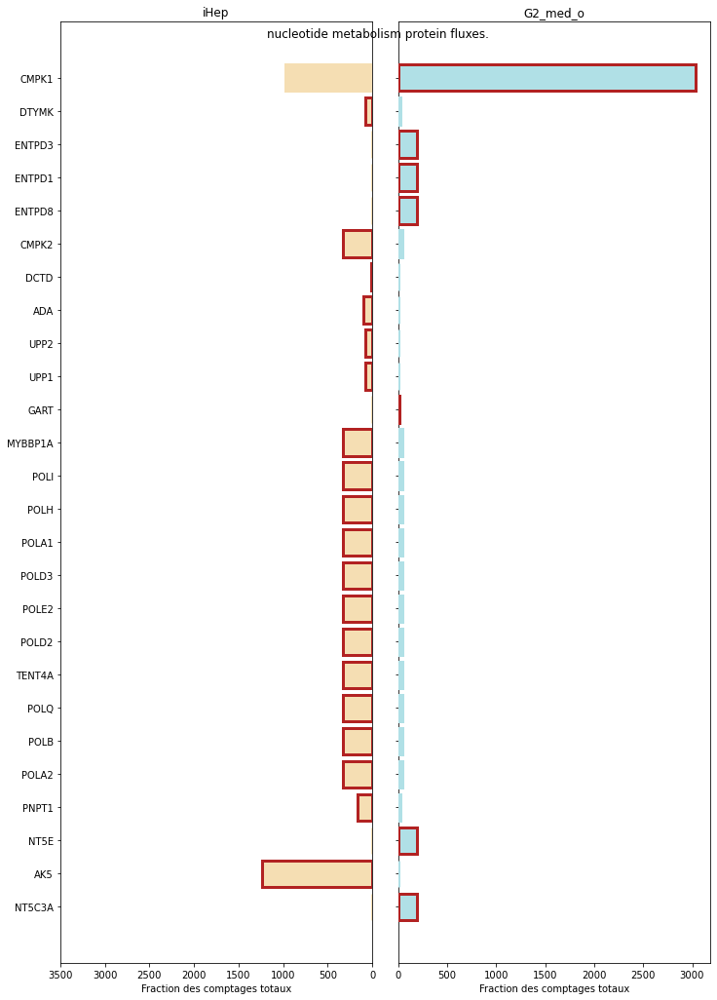

In [34]:
barplots_dict["nucleotide metabolism"][0]

---
#### Glycolysis reactions
--> On s'attend à observer : 
- une activité très réduite de FBP1, PCK1/2, PKLR, GPI, PFKL, ALDOA/B/C, TPI, PC 
- une activité similaire entre modèle cancéreux et sain de GAPDH, PGK1/2, PGAM1, ENO1/2/3, LDHA.

--> On observe :
- Correct : Activité importante de la pyruvate kinase chez les deux types cellulaires : gènes **PKLR/PKM**.
  - *en théorie, PKLR est prédominante dans les cellules saines, et PKM dans les cellules cancéreuses. La nature booléenne de l'association GPR ne permet pas de différencier les deux.*


- Correct : activité légèrement plus importante de **TPI** Chez le modèle sain par rapport au modèle cancéreux.
- Correct : Activité globalement plus importante pour les **enzymes de la glycolyse** dans le modèle cancéreux :
  - **GPI, HK1/2/3** --> + de glycolyse et donc plus de fermentation, et d'activité vers la voie des pentoses phosphates.

In [ ]:
barplots_dict_2["glycolysis / gluconeogenesis"][0]

In [42]:
type(barplots_dict.items())

dict_items

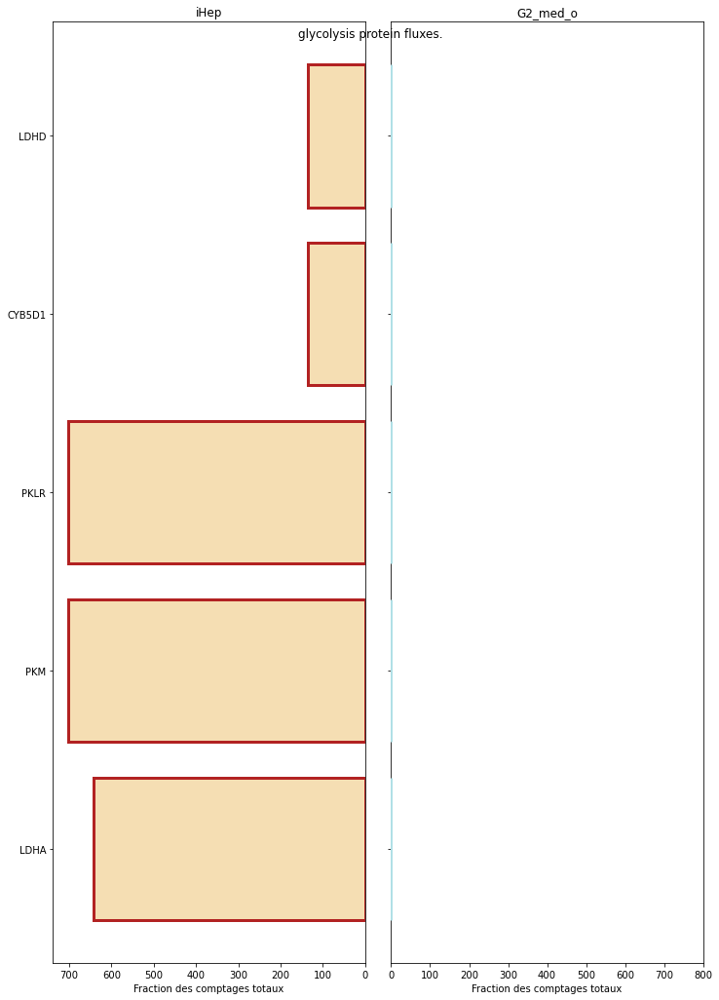

In [33]:
barplots_dict['glycolysis'][0]

--- 
#### Pyruvate metabolism :

Cette figure sert surtout en conjonction avec la précédente où on peut voir que les flux associés aux gènes PKLM et PKR sont les mêmes entre le modèle sain et cancéreux. 

In [ ]:
barplots_dict_2["pyruvate metabolism"][0]

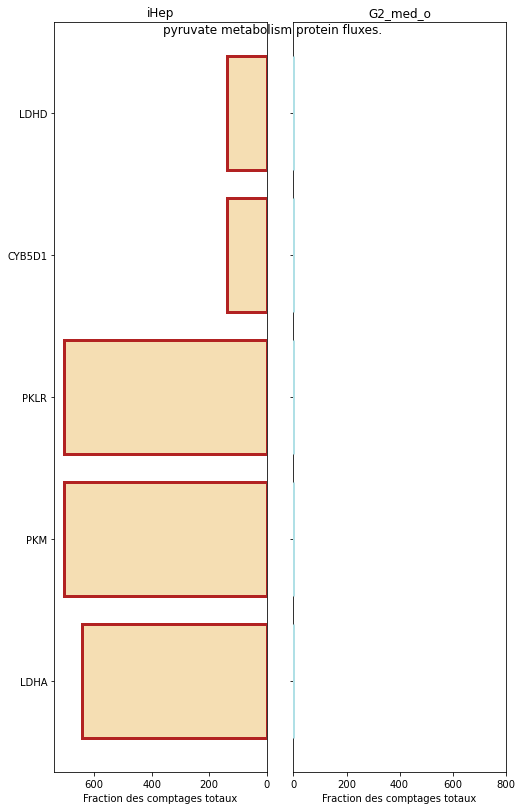

In [25]:
barplots_dict["pyruvate metabolism"][0]

#### Pentose phosphate pathway

On s'attend à une activité de la voie des pentoses phosphates plus importante chez la cellule cancéreuse que chez la cellule saine, pourtant ce n'est pas du tout le cas.

La seule activité plus importante pour le modèle cancéreuse est celle de la phosphofructokinase. Or il s'agit d'une enzyme censée être sous-exprimée dans une cellule cancéreuse.

In [ ]:
barplots_dict_2["pentose phosphate pathway"][0]

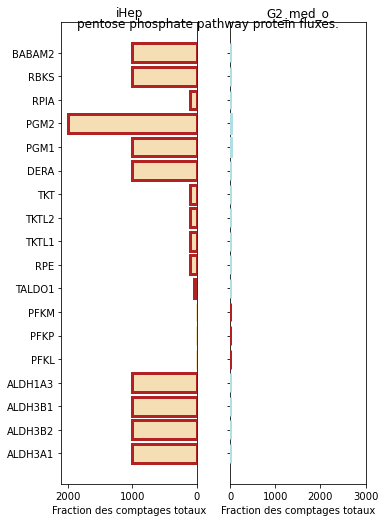

In [26]:
barplots_dict["pentose phosphate pathway"][0]

#### Folate metabolism

Le métabolisme du folate est supposé être suractivé dans une cellule cancéreuse.

C'est bien ce qu'on observe ici avec une activité beaucoup plus importante de DHFR, qui est d'ailleurs une cible thérapeutique anticancéreuse connue.

In [ ]:
barplots_dict_2["folate metabolism"][0]

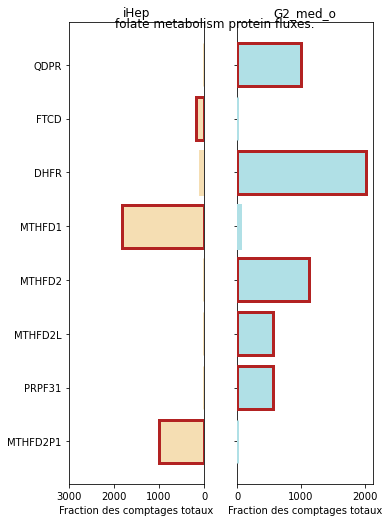

In [27]:
barplots_dict["folate metabolism"][0]

#### Beta oxidation

On s'attend à une activité très réduite des protéines de la beta-oxydation (ici, toutes les beta oxydations sont regroupées : mitochondriale et peroxysomale)

On observe effectivement une activité inexistante (flux nuls)

In [ ]:
barplots_dict_2["beta oxidation"][0]

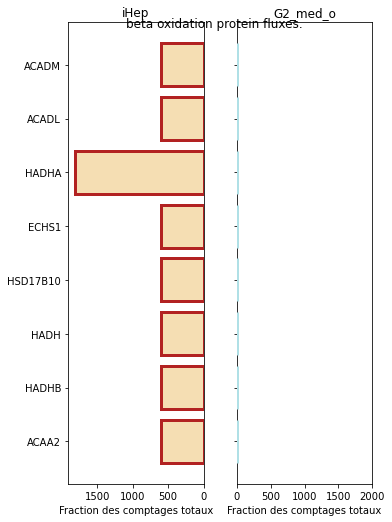

In [28]:
barplots_dict["beta oxidation"][0]

#### Carnitine shuttle

On s'attend à une activité très réduite des protéines associées à la navette carnitine.

On observe effectivement une activité très réduite de ces protéines.

In [ ]:
barplots_dict_2["carnitine shuttle"][0]

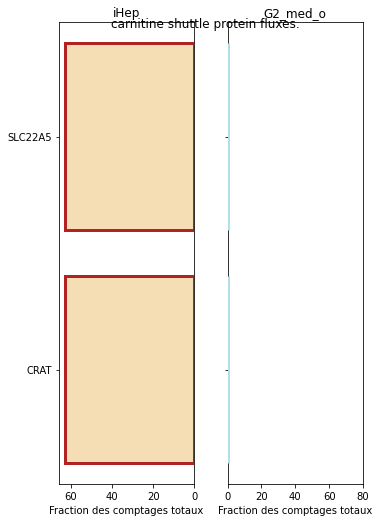

In [29]:
barplots_dict["carnitine shuttle"][0]

### Treemaps -- BY SUBSYSTEM

In [1]:
Subsystem_fluxes_cancer = vu.build_reaction_df(HepG2, False)
treemap_dataframe = pd.DataFrame(Subsystem_fluxes_cancer["Glycolysis / Gluconeogenesis"])
title = "Glycolysis reactions -- <b>CANCER MODEL<br />"

vu.plot_treemap(treemap_dataframe, HepG2, title, path = ["compartment", "id"], color_by="compartment")

NameError: name 'vu' is not defined

In [ ]:
Subsystem_fluxes_healthy = vu.build_reaction_df(iHep, False)
treemap_dataframe = pd.DataFrame(Subsystem_fluxes_healthy["Glycolysis / Gluconeogenesis"])
title = "Glycolysis reactions -- <b>HEALTHY MODEL<br />"

vu.plot_treemap(treemap_dataframe, iHep, title, path = ["compartment", "id"], color_by="compartment")

### Treemaps + barplots -- BY COMPARTMENT

#### Cytoplasme

In [78]:
title = "Cytoplasm reactions -- <b>CANCER MODEL<br />"
vu.plot_treemap(df_C,HepG2,title).show(renderer = 'notebook')

In [79]:
title = "Cytoplasm reactions -- <b>HEALTHY MODEL <br />"
vu.plot_treemap(df_Ci, iHep, title).show(renderer = "notebook")

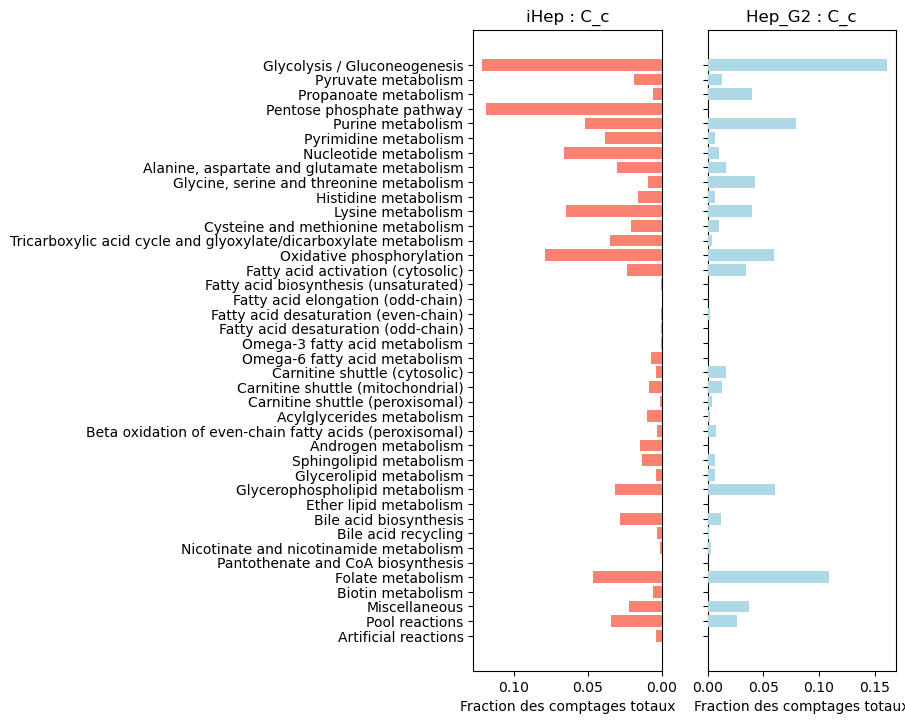

In [12]:
barplots_dict["C_c"][0]

#### Mitochondrie

In [13]:
title="Mitochondrial reactions -- <b>HEALTHY MODEL<br />"
vu.plot_treemap(df_Mi, iHep, title).show(renderer = "notebook")

In [14]:
title="Mitochondrial reactions -- <b>CANCER MODEL<br />"
vu.plot_treemap(df_M, HepG2, title).show(renderer = "notebook")

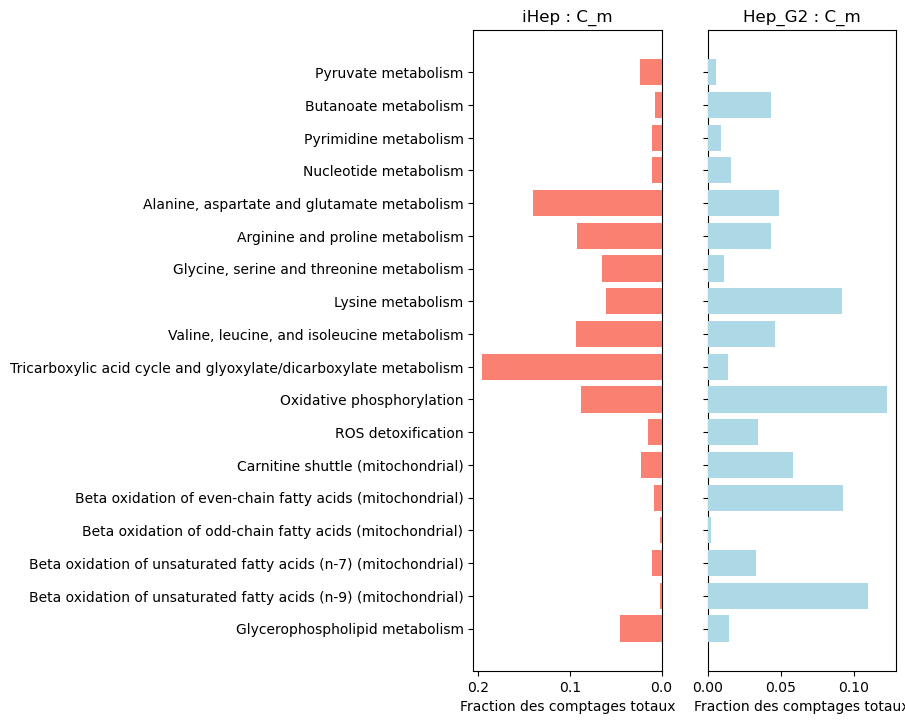

In [15]:
barplots_dict["C_m"][0]

#### Peroxysome

In [16]:
title="Peroxysomal reactions -- <b>HEALTHY MODEL<br />"
vu.plot_treemap(df_Pi, iHep, title).show(renderer = "notebook")

In [19]:
title="Peroxysomal reactions -- <b>CANCER MODEL<br />"
vu.plot_treemap(df_P, HepG2, title).show(renderer = "notebook")

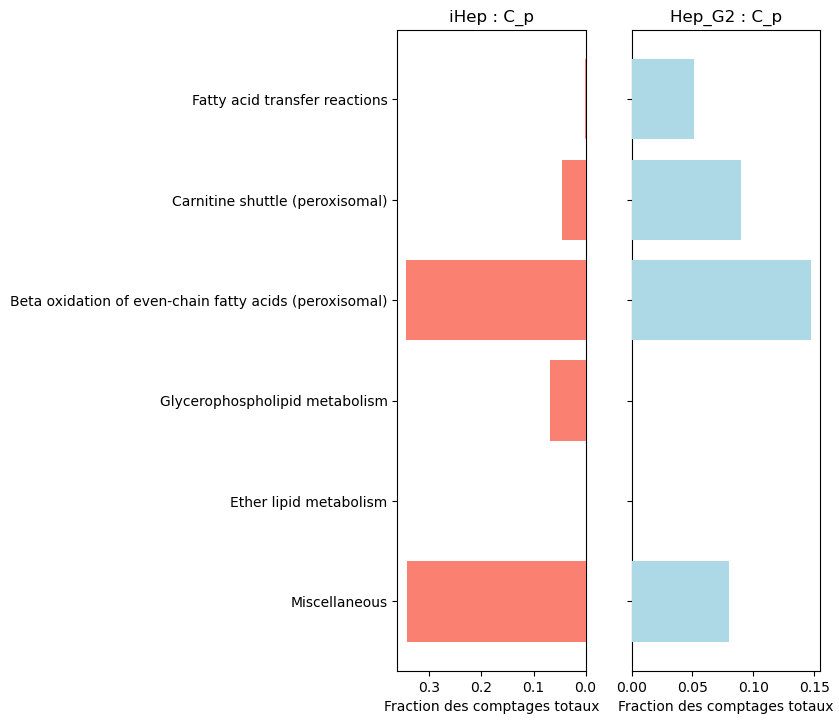

In [18]:
barplots_dict["C_p"][0]